In [1]:
import os              
os.environ['PYTHONHASHSEED'] = '0'
import desc          
import pandas as pd                                                    
import numpy as np                                                     
import scanpy as sc                                                                              
from time import time                                                       
import sys
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline 
sc.settings.set_figure_params(dpi=300)
from matplotlib import rcParams

In [2]:
print(sys.version)

3.6.11 | packaged by conda-forge | (default, Aug  5 2020, 20:19:23) 
[GCC Clang 10.0.1 ]


In [3]:
sc.__version__

'1.6.0'

In [4]:
desc.__version__

'2.1.1'

In [5]:
import tensorflow as tf
tf.__version__

'2.3.1'

In [6]:
adata = sc.read_10x_mtx(
    '/Users/fernandes/Documents/scRNA-seq_demo_data/sample_6/',  # the directory with the `.mtx` file
    var_names='gene_symbols',                # use gene symbols for the variable names (variables-axis index)
    cache=True)                          # write a cache file for faster subsequent reading


In [7]:
sc.pp.log1p(adata)
#sc.pp.filter_genes_dispersion(adata,n_top_genes=1000) #older scanpy
sc.pp.highly_variable_genes(adata,n_top_genes=1000,subset=True,inplace=True)

In [8]:
adata.var['mt'] = adata.var_names.str.startswith('mt')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

/Users/fernandes/anaconda3/envs/DESC/lib/python3.6/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/Users/fernandes/anaconda3/envs/DESC/lib/python3.6/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/Users/fernandes/anaconda3/envs/DESC/lib/python3.6/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/Users/fernandes/anaconda3/envs/DESC/lib/python3.6/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))
/Users/fernandes/anaconda3/envs/DESC/lib/python3.6/site-packages/seaborn/_core.py:1303: UserWarning: Vertical orientation ignored with only 

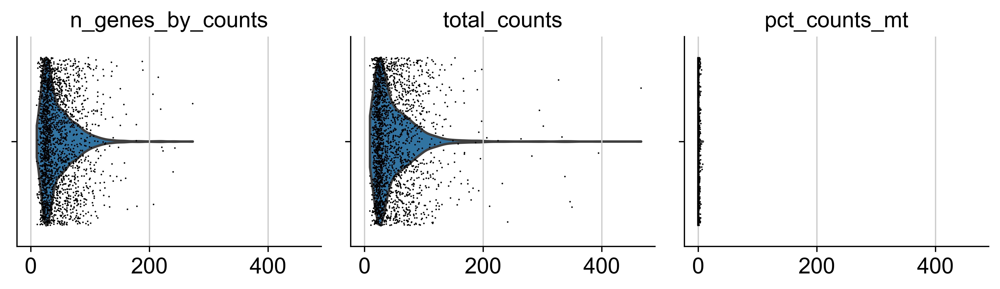

In [9]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

In [10]:
desc.normalize_per_cell(adata, counts_per_cell_after=1e4)

In [11]:
adata.raw=adata

In [12]:
desc.scale(adata, zero_center=True, max_value=3)

In [13]:
sc.pp.scale(adata,max_value=6)# if the the dataset has two or more batches you can use `adata=desc.scale(adata,groupby="BatchID")`
save_dir="test_DESC"
adata=desc.train(adata,
        dims=[adata.shape[1],64,32],
        tol=0.005,
        n_neighbors=10,
        batch_size=256,
        louvain_resolution=[1.0],# not necessarily a list, you can only set one value, like, louvain_resolution=1.0
        save_dir=str(save_dir),
        do_tsne=True,
        learning_rate=200, # the parameter of tsne
        use_GPU=False,
        num_Cores=1, #for reproducible, only use 1 cpu
        num_Cores_tsne=4,
        save_encoder_weights=False,
        save_encoder_step=3,# save_encoder_weights is False, this parameter is not used
        use_ae_weights=False,
        do_umap=True) #if do_umap is False, it will don't compute umap coordiate

Start to process resolution= 1.0
The number of cpu in your computer is 4

Create the directory:test_DESC to save result
('Failed to import pydot. You must `pip install pydot` and install graphviz (https://graphviz.gitlab.io/download/), ', 'for `pydotprint` to work.')
use_ae_weights=False, the program will rerun autoencoder
Pretraining the 1th layer...
learning rate = 0.1
Epoch 1/50
9/9 [==============================] - 0s 5ms/step - loss: 0.5993
Epoch 2/50
9/9 [==============================] - 0s 5ms/step - loss: 0.5911
Epoch 3/50
9/9 [==============================] - 0s 6ms/step - loss: 0.5799
Epoch 4/50
9/9 [==============================] - 0s 7ms/step - loss: 0.5721
Epoch 5/50
9/9 [==============================] - 0s 6ms/step - loss: 0.5653
Epoch 6/50
9/9 [==============================] - 0s 6ms/step - loss: 0.5599
Epoch 7/50
9/9 [==============================] - 0s 6ms/step - loss: 0.5547
Epoch 8/50
9/9 [==============================] - 0s 6ms/step - loss: 0.5511
Epoch 9/50

9/9 [==============================] - 0s 1ms/step - loss: 0.1658
Epoch 21/50
9/9 [==============================] - 0s 2ms/step - loss: 0.1670
Epoch 22/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1655
Epoch 23/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1632
Epoch 24/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1590
Epoch 25/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1569
Epoch 26/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1546
Epoch 27/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1512
Epoch 28/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1523
Epoch 29/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1507
Epoch 30/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1464
Epoch 31/50
9/9 [==============================] - 0s 1ms/step - loss: 0.1471
Epoch 32/50
9/9 [==============================] - 0s 1ms/step - loss: 0.145

9/9 [==============================] - 0s 4ms/step - loss: 0.4559
Epoch 13/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4548
Epoch 14/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4538
Epoch 15/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4529
Epoch 16/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4520
Epoch 17/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4511
Epoch 18/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4503
Epoch 19/50
9/9 [==============================] - 0s 3ms/step - loss: 0.4494
Epoch 20/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4487
Epoch 21/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4480
Epoch 22/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4472
Epoch 23/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4465
Epoch 24/50
9/9 [==============================] - 0s 5ms/step - loss: 0.445

9/9 [==============================] - 0s 4ms/step - loss: 0.4317
Epoch 6/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4317
Epoch 7/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4317
Epoch 8/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4317
Epoch 9/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4317
Epoch 10/50
9/9 [==============================] - 0s 5ms/step - loss: 0.4317
Epoch 11/50
9/9 [==============================] - 0s 5ms/step - loss: 0.4317
Epoch 00011: early stopping
learning rate = 0.0001
Epoch 1/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4317
Epoch 2/50
9/9 [==============================] - 0s 4ms/step - loss: 0.4317
Epoch 3/50
9/9 [==============================] - 0s 5ms/step - loss: 0.4317
Epoch 4/50
9/9 [==============================] - 0s 5ms/step - loss: 0.4317
Epoch 5/50
9/9 [==============================] - 0s 5ms/step - loss: 0.4317
Epoch 6/50
9/9 [==================

Epoch 1/5
9/9 [==============================] - 0s 3ms/step - loss: 0.2449
Epoch 2/5
9/9 [==============================] - 0s 3ms/step - loss: 0.2387
Epoch 3/5
9/9 [==============================] - 0s 2ms/step - loss: 0.2327
Epoch 4/5
9/9 [==============================] - 0s 3ms/step - loss: 0.2269
Epoch 5/5
9/9 [==============================] - 0s 3ms/step - loss: 0.2214
The value of delta_label of current 14 th iteration is 0.010803193987787695 >= tol 0.005
Epoch 1/5
9/9 [==============================] - 0s 3ms/step - loss: 0.2556
Epoch 2/5
9/9 [==============================] - 0s 3ms/step - loss: 0.2494
Epoch 3/5
9/9 [==============================] - 0s 3ms/step - loss: 0.2436
Epoch 4/5
9/9 [==============================] - 0s 3ms/step - loss: 0.2379
Epoch 5/5
9/9 [==============================] - 0s 2ms/step - loss: 0.2325
The value of delta_label of current 15 th iteration is 0.011742602160638797 >= tol 0.005
Epoch 1/5
9/9 [==============================] - 0s 3ms/step -

In [14]:
adata

AnnData object with n_obs × n_vars = 2129 × 1000
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'desc_1.0'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'log1p', 'hvg', 'umap', 'prob_matrix1.0'
    obsm: 'X_Embeded_z1.0', 'X_tsne', 'X_tsne1.0', 'X_umap', 'X_umap1.0'
    obsp: 'distances', 'connectivities'

In [15]:
adata.obs['max.prob']=adata.uns["prob_matrix1.0"].max(1)

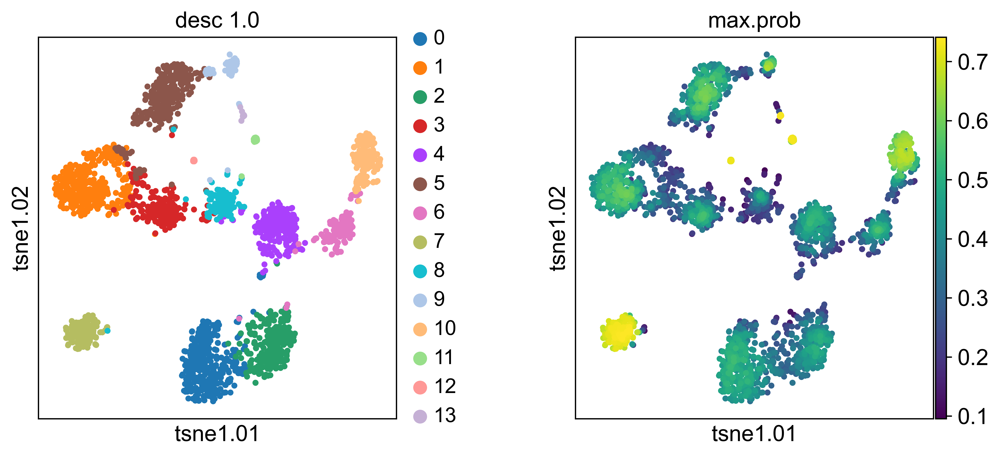

In [16]:
sc.pl.scatter(adata,basis="tsne1.0",color=['desc_1.0','max.prob'])

In [17]:
rcParams['figure.figsize'] = 10,10
sc.pl.umap(adata,color=['desc_1.0','max.prob'])

In [18]:
sc.pp.neighbors(adata, n_pcs = 30, n_neighbors = 20)

sc.tl.leiden(adata)

         Falling back to preprocessing with `sc.pp.pca` and default params.


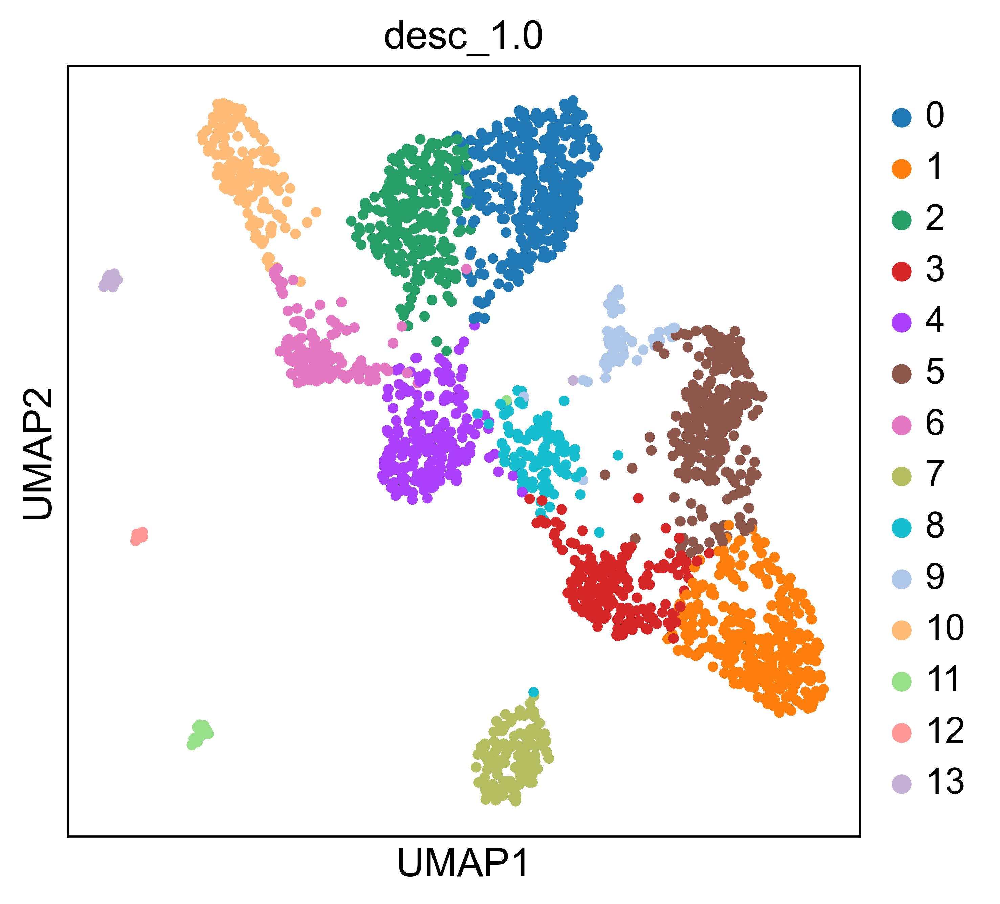

In [19]:
rcParams['figure.figsize'] = 5,5
sc.pl.umap(adata,color=['desc_1.0'])

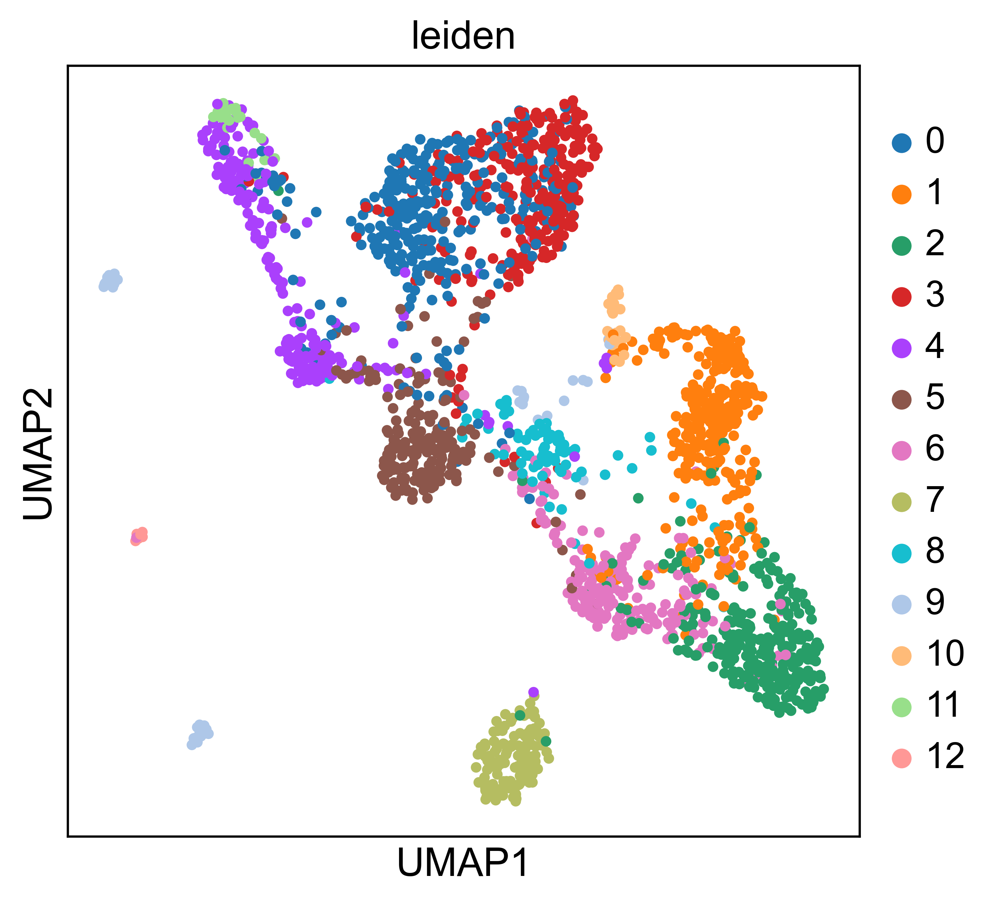

In [20]:
rcParams['figure.figsize'] = 5,5
sc.pl.umap(adata,color=['leiden'])

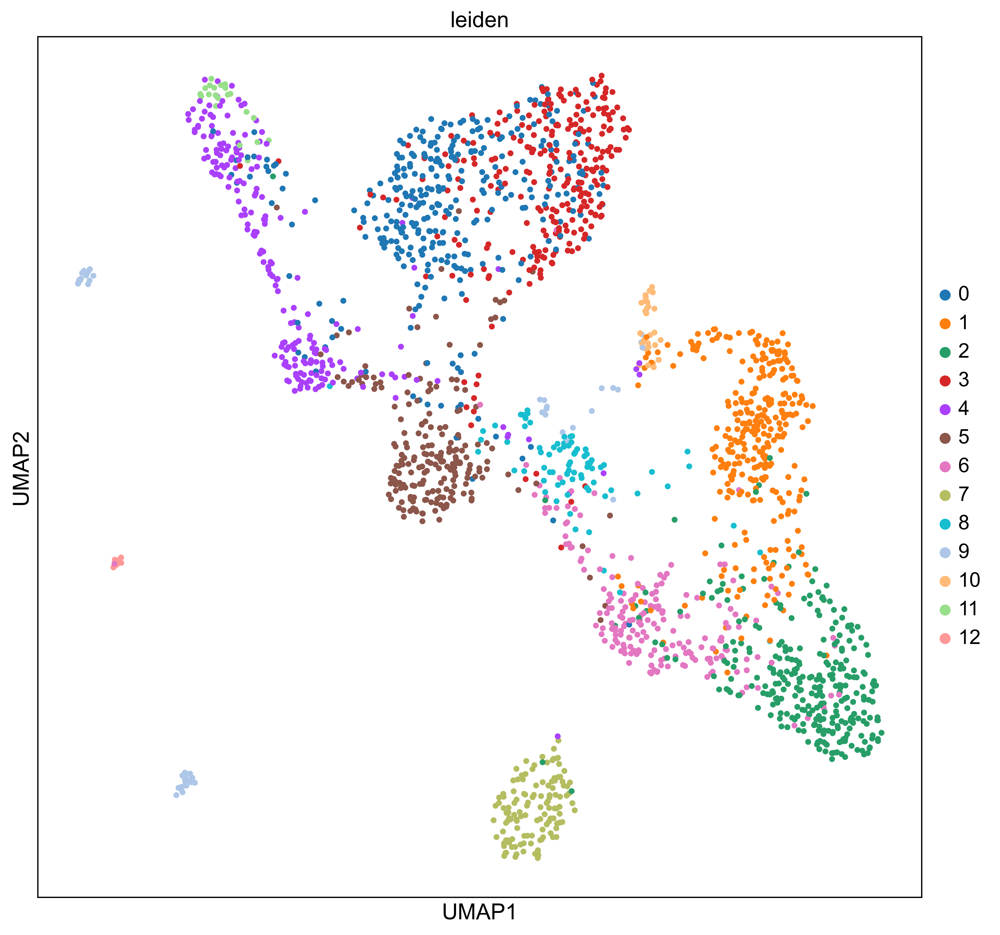

In [21]:
rcParams['figure.figsize'] = 10,10
sc.pl.umap(adata, color='leiden')


In [22]:
adata.write('desc_result.h5ad')

### One thing virtually all clustering or community detection methods have in common is some flavor of a resolution parameter. This parameter controls how fine- or coarse-grained the inferred clusters are. This parameter can have major effects on your results!

'''see https://chanzuckerberg.github.io/scRNA-python-workshop/analysis/04-clustering.html'''

In [24]:
sc.tl.leiden(adata, key_added = "leiden_1.0") # default resolution in 1.0
sc.tl.leiden(adata, resolution = 0.6, key_added = "leiden_0.6")
sc.tl.leiden(adata, resolution = 0.4, key_added = "leiden_0.4")
sc.tl.leiden(adata, resolution = 1.4, key_added = "leiden_1.4")

In [25]:
sc.pl.umap(adata, color=['leiden_0.4', 'leiden_0.6', 'leiden_1.0','leiden_1.4'])

In [26]:
sc.tl.louvain(adata, key_added = "louvain_1.0") # default resolution in 1.0
sc.tl.louvain(adata, resolution = 0.6, key_added = "louvain_0.6")
sc.tl.louvain(adata, resolution = 0.4, key_added = "louvain_0.4")
sc.tl.louvain(adata, resolution = 1.4, key_added = "louvain_1.4")

sc.pl.umap(adata, color=['louvain_0.4', 'louvain_0.6', 'louvain_1.0','louvain_1.4'])

In [27]:
adata

AnnData object with n_obs × n_vars = 2129 × 1000
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'desc_1.0', 'max.prob', 'leiden', 'leiden_1.0', 'leiden_0.6', 'leiden_0.4', 'leiden_1.4', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'log1p', 'hvg', 'umap', 'prob_matrix1.0', 'desc_1.0_colors', 'neighbors', 'leiden', 'leiden_colors', 'leiden_0.4_colors', 'leiden_0.6_colors', 'leiden_1.0_colors', 'leiden_1.4_colors', 'louvain', 'louvain_0.4_colors', 'louvain_0.6_colors', 'louvain_1.0_colors', 'louvain_1.4_colors'
    obsm: 'X_Embeded_z1.0', 'X_tsne', 'X_tsne1.0', 'X_umap', 'X_umap1.0', 'X_pca'
    obsp: 'distances', 'connectivities'

In [28]:
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

# extract pca coordinates
X_pca = adata.obsm['X_pca'] 

# kmeans with k=5
kmeans = KMeans(n_clusters=5, random_state=0).fit(X_pca) 
adata.obs['kmeans5'] = kmeans.labels_.astype(str)

# kmeans with k=10
kmeans = KMeans(n_clusters=10, random_state=0).fit(X_pca) 
adata.obs['kmeans10'] = kmeans.labels_.astype(str)

# kmeans with k=15
kmeans = KMeans(n_clusters=15, random_state=0).fit(X_pca) 
adata.obs['kmeans15'] = kmeans.labels_.astype(str)

sc.pl.umap(adata, color=['kmeans5', 'kmeans10', 'kmeans15'])

... storing 'kmeans5' as categorical
... storing 'kmeans10' as categorical
... storing 'kmeans15' as categorical


In [29]:
from sklearn.cluster import AgglomerativeClustering

cluster = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
adata.obs['hclust_5'] = cluster.fit_predict(X_pca).astype(str)

cluster = AgglomerativeClustering(n_clusters=10, affinity='euclidean', linkage='ward')
adata.obs['hclust_10'] = cluster.fit_predict(X_pca).astype(str)

cluster = AgglomerativeClustering(n_clusters=15, affinity='euclidean', linkage='ward')
adata.obs['hclust_15'] = cluster.fit_predict(X_pca).astype(str)


sc.pl.umap(adata, color=['hclust_5', 'hclust_10', 'hclust_15'])

... storing 'hclust_5' as categorical
... storing 'hclust_10' as categorical
... storing 'hclust_15' as categorical
